# Human pose estimation with YoloV7

https://github.com/WongKinYiu/yolov7

In [22]:
#!pip install moviepy

In [23]:
#pip install --upgrade torchvision

In [24]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
import urllib.request
import sys
import torch
import time
import datetime

from torchvision import transforms
from PIL import Image
from moviepy.editor import *

%matplotlib inline

## 1. Cloning YoloV7 repo

In [25]:
YOLO_DIR = 'yolov7'

In [26]:
if not os.path.exists(YOLO_DIR):
    print("Starting to clone the YoloV7 repo\n")
    !git clone https://github.com/WongKinYiu/yolov7.git
    print("\nDone")

if os.path.exists(YOLO_DIR):
    print("\nDirectory is present:\n")
    !ls yolov7


Directory is present:

cfg	   export.py   LICENSE.md  requirements.txt  train_aux.py
data	   figure      models	   scripts	     train.py
deploy	   hubconf.py  paper	   test.py	     utils
detect.py  inference   README.md   tools	     yolov7-w6-pose.pt


In [27]:
RESULTS_DIR = 'results'

if not os.path.exists(RESULTS_DIR):
    print("Creating the directory:", RESULTS_DIR)
    os.mkdir(RESULTS_DIR)
    print("Done")

## 2. YoloV7 models

Models:
https://github.com/WongKinYiu/yolov7/#performance

In [28]:
YOLOV7_MODEL = ["https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-w6-pose.pt"]

In [29]:
print("List of YoloV7 models:\n")
YOLOV7_MODEL

List of YoloV7 models:



['https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-w6-pose.pt']

In [30]:
def get_yolov7_model(modelistid=1):
    """
    Download YoloV7 model from a yoloV7 model list
    """
    modelid = YOLOV7_MODEL[modelistid]

    if not os.path.exists(modelid):
        print("Downloading the model:",
              os.path.basename(modelid), "from:", modelid)
        urllib.request.urlretrieve(modelid, 
                                   filename=os.path.basename(modelid))
        print("Done\n")
        !ls yolo*.pt -lh

    if os.path.exists(modelid):
        print("Downloaded model files:")
        !ls yolo*.pt -lh

## 3. Using YoloV7 models on images

In [31]:
os.chdir(YOLO_DIR)

In [32]:
from utils.datasets import letterbox
from utils.general import non_max_suppression_kpt
from utils.plots import output_to_keypoint, plot_skeleton_kpts

In [33]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [34]:
def image_view(imagefile, w=15, h=10):
    """
    Displaying an image from an image file
    """
    %matplotlib inline
    plt.figure(figsize=(w, h))
    plt.axis('off')
    plt.imshow(cv2.cvtColor(cv2.imread(imagefile), 
                            cv2.COLOR_BGR2RGB))

In [35]:
def loading_yolov7_model(yolomodel):
    """
    Loading yolov7 model
    """
    print("Loading model:", yolomodel)
    model = torch.load(yolomodel, map_location=device)['model']
    model.float().eval()

    if torch.cuda.is_available():
        # half() turns predictions into float16 tensors
        # which significantly lowers inference time
        model.half().to(device)

    return model, yolomodel

In [36]:
def running_inference(image):
    """
    Running yolov7 model inference
    """
    image = letterbox(image, 960, 
                      stride=64,
                      auto=True)[0]  # shape: (567, 960, 3)
    image = transforms.ToTensor()(image)  # torch.Size([3, 567, 960])

    if torch.cuda.is_available():
        image = image.half().to(device)

    image = image.unsqueeze(0)  # torch.Size([1, 3, 567, 960])

    with torch.no_grad():
        output, _ = model(image)

    return output, image

In [37]:
def draw_keypoints(output, image, confidence=0.25, threshold=0.65):
    """
    Draw YoloV7 pose keypoints
    """
    keypoints = []

    output = non_max_suppression_kpt(
        output,
        confidence,  # Confidence Threshold
        threshold,  # IoU Threshold
        nc=model.yaml['nc'],  # Number of Classes
        nkpt=model.yaml['nkpt'],  # Number of Keypoints
        kpt_label=True)

    with torch.no_grad():
        output = output_to_keypoint(output)

    nimg = image[0].permute(1, 2, 0) * 255
    nimg = cv2.cvtColor(nimg.cpu().numpy().astype(np.uint8), cv2.COLOR_RGB2BGR)

    for idx in range(output.shape[0]):
        plot_skeleton_kpts(nimg, output[idx, 7:].T, 3)

        keypoints.append(output[idx, 7:].reshape((17, 3)))

    return nimg, keypoints

### 3.2 Using the yolov7-w6-pose model

In [38]:
YOLOV7_MODEL[0]

'https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-w6-pose.pt'

In [39]:
get_yolov7_model(0)

Done

-rw-rw-r-- 1 amitabha amitabha 154M Mar  7 22:49 yolov7-w6-pose.pt


In [40]:
YOLOV7MODEL = os.path.basename(YOLOV7_MODEL[0])

try:
    print("Loading the model...")
    model, yolomodel = loading_yolov7_model(yolomodel=YOLOV7MODEL)
    print("Using the", YOLOV7MODEL, "model")
    print("Done")

except:
    print("[Error] Cannot load the model", YOLOV7MODEL)

Loading the model...
Loading model: yolov7-w6-pose.pt
Using the yolov7-w6-pose.pt model
Done


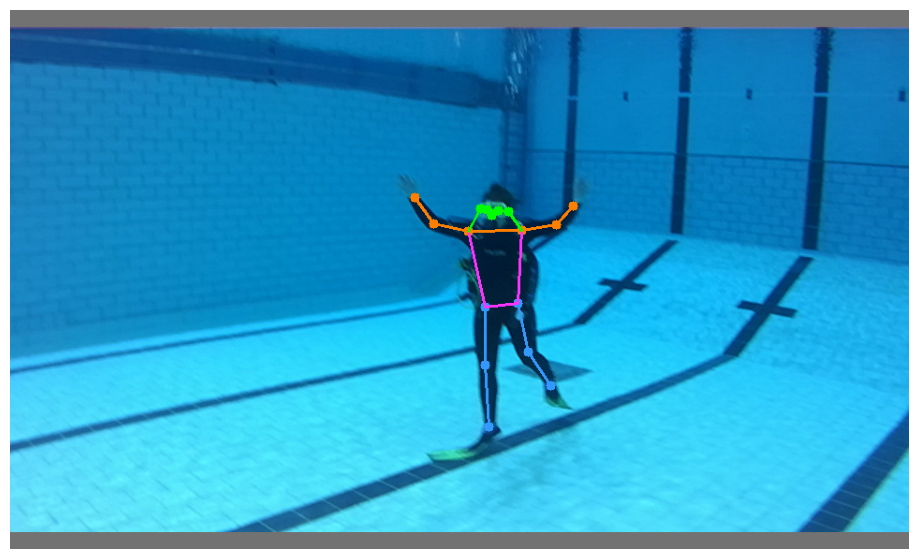

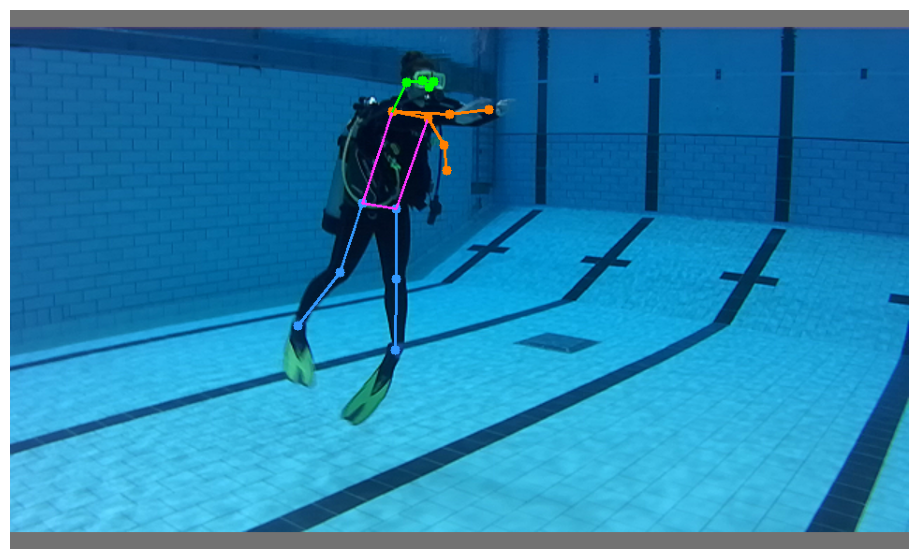

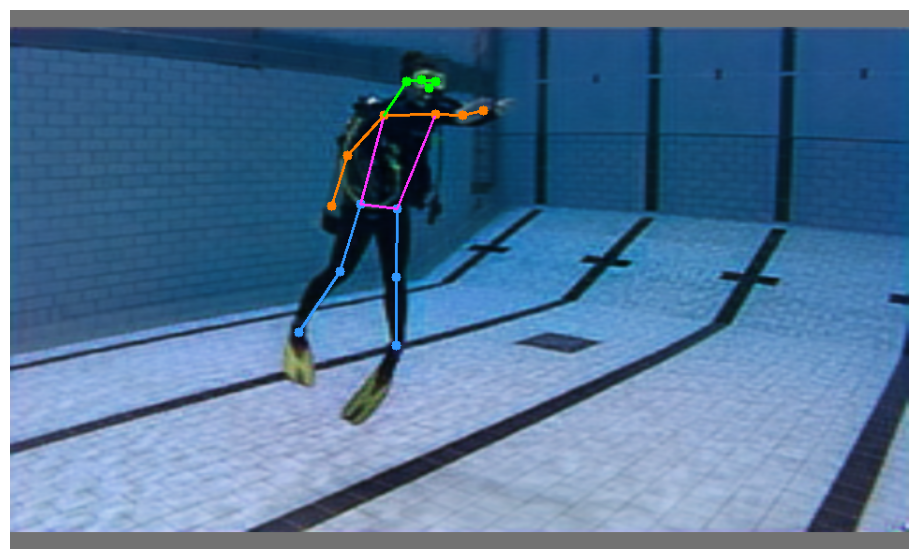

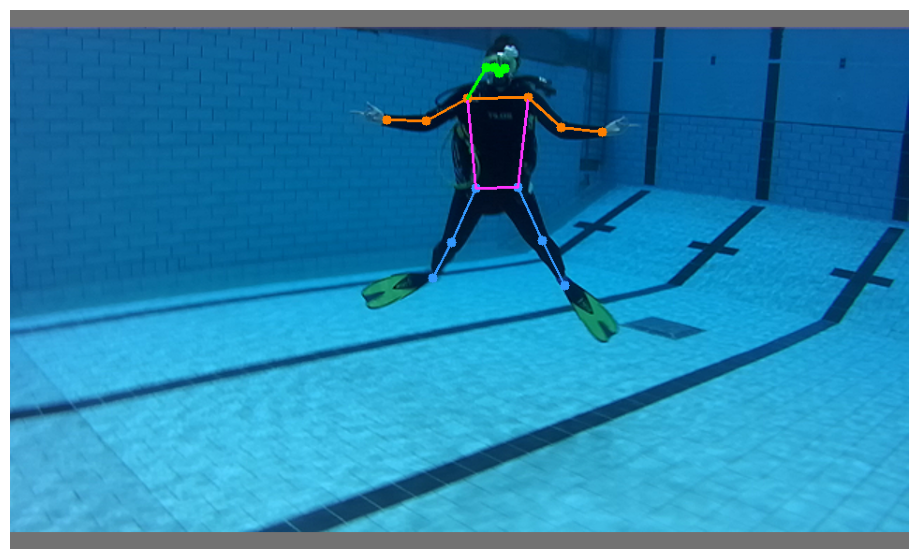

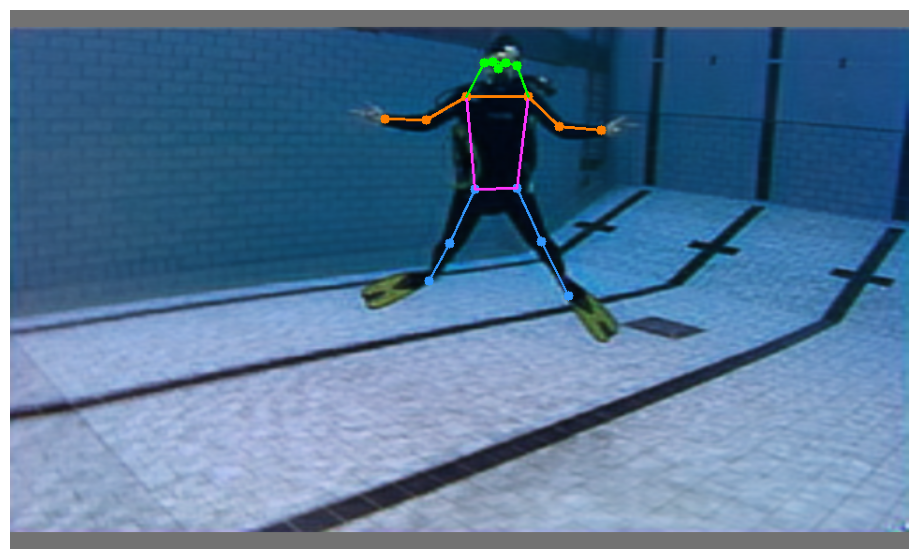

...

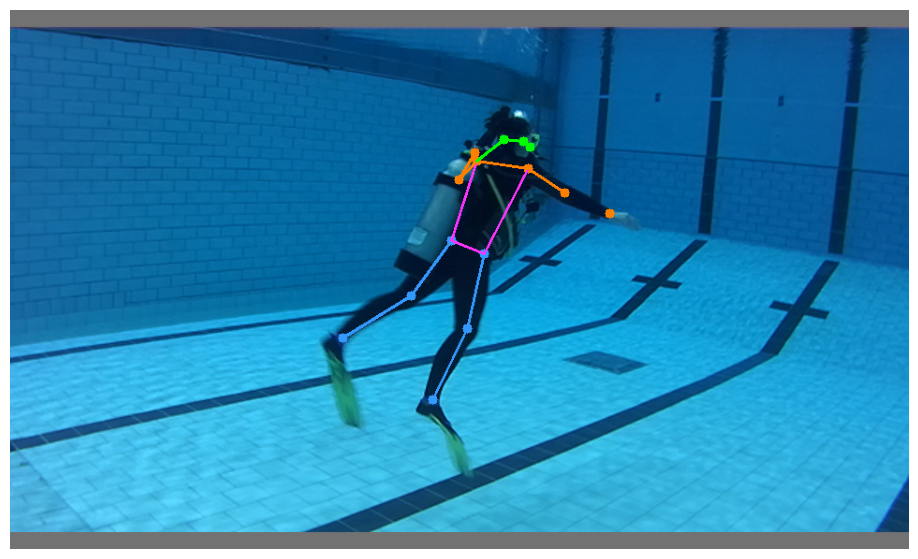

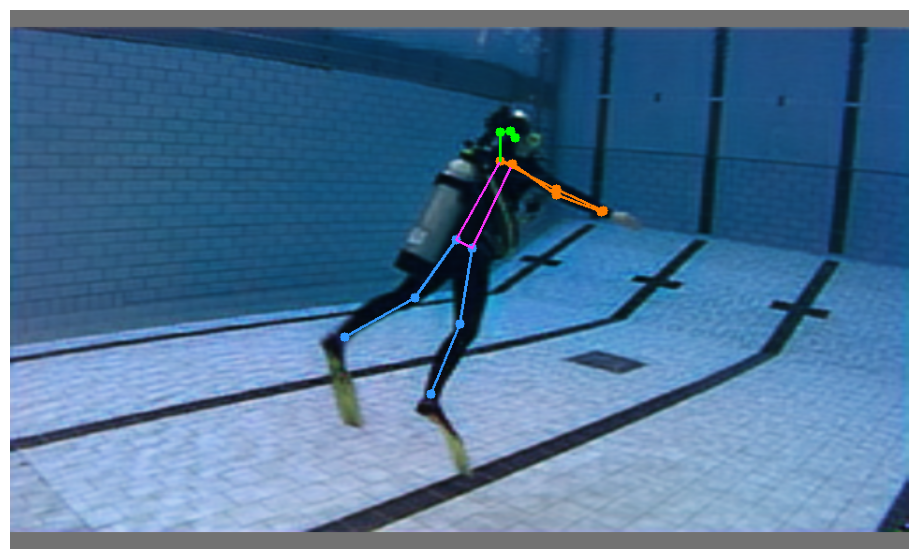

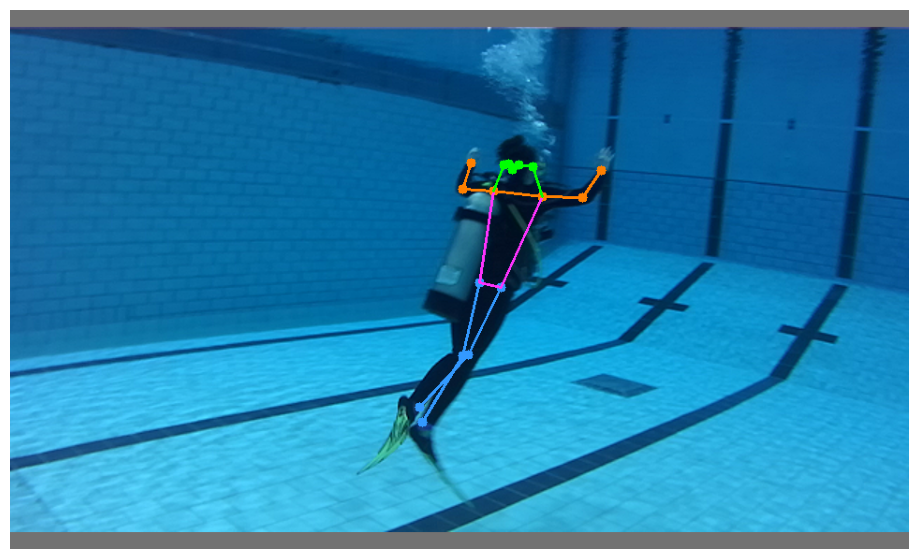

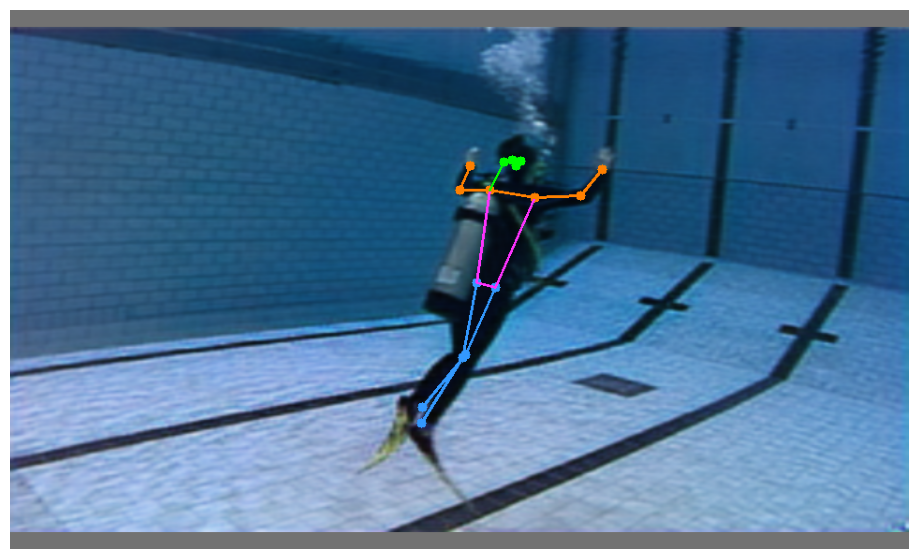

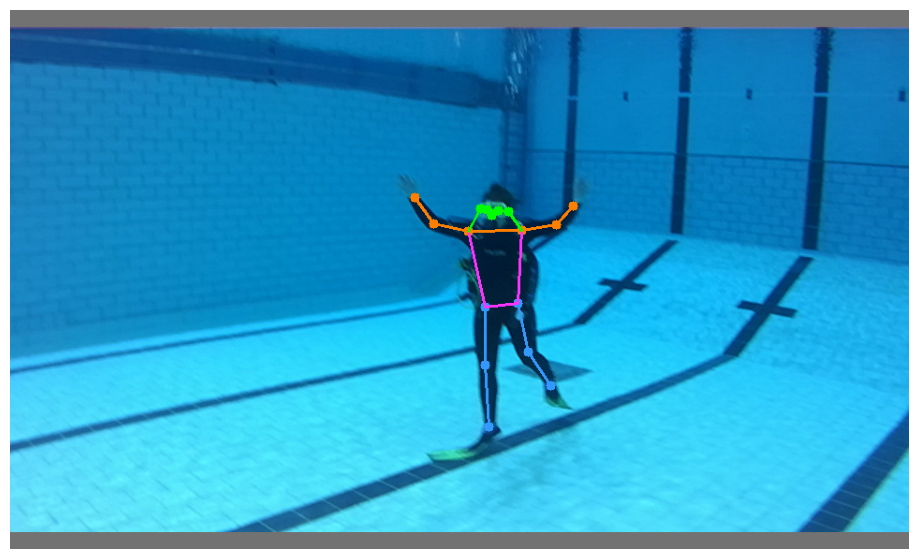

In [41]:
imagefile = "/home/amitabha/capstone/pool_may051623/Pose_Data_Pool/img_001_left.png"

output, image = running_inference(cv2.imread(imagefile))
pose_image, coordinates = draw_keypoints(output, image, confidence=0.25, threshold=0.65)

plt.figure(figsize=(30, 7))
plt.axis("off")
plt.imshow(pose_image)


gt = [287.85,122.69,2,302.64,140.35,2,326.74,148.78,2,337.96,131.09,2,348.23,130.91,2,340.91,143.47,2,350.17,141.82,2,366.22,147.2,2,390.14,139.74,2,402.39,126.09,2,358.68,141.64,1,353.94,205.58,1,337.16,199.48,2,368.62,199.36,2,337.65,237.29,2,369.0,236.65,2,341.6,283.9,2,383.52,250.68,2,300.47,307.56,2,394.88,271.2,2]

gt = np.array(gt).reshape((20, 3))


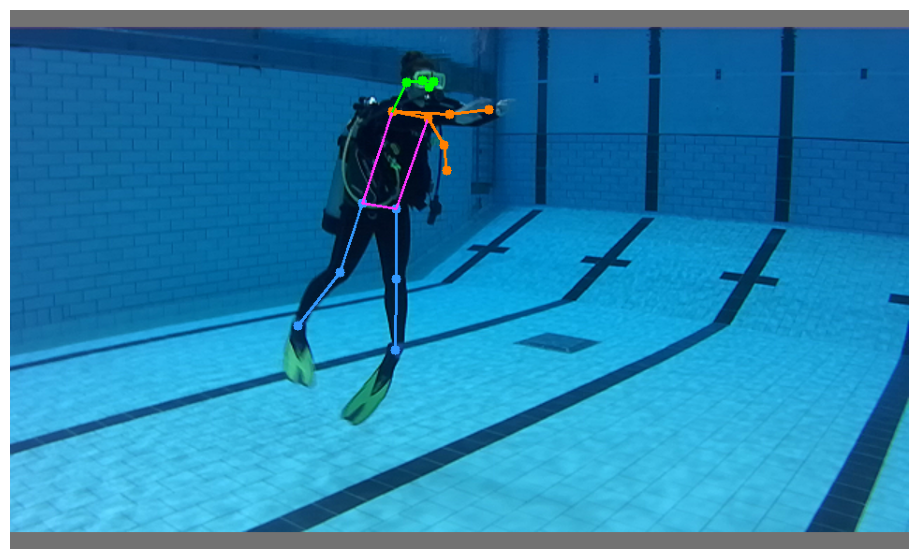

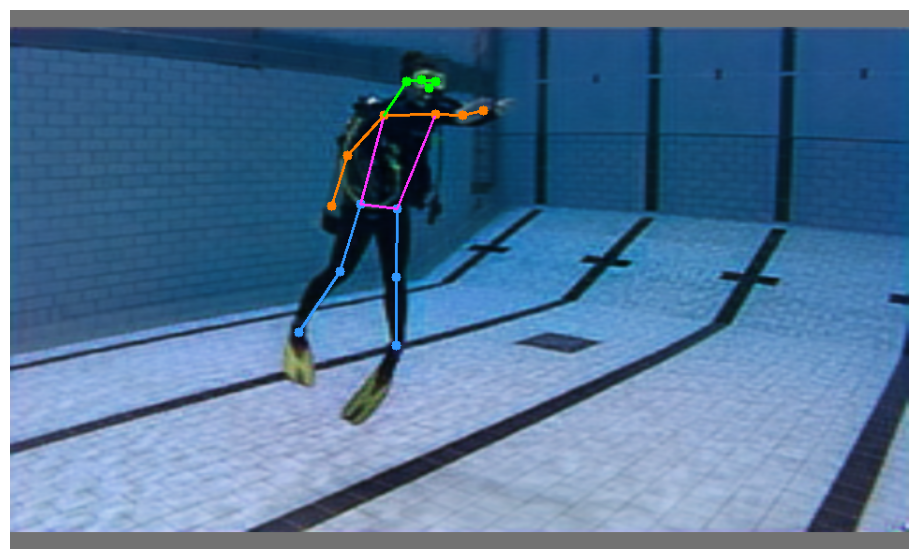

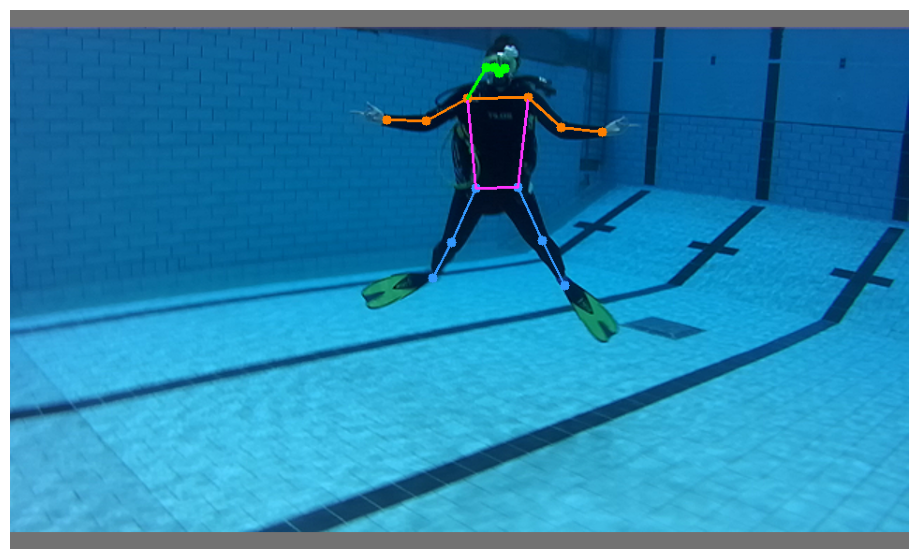

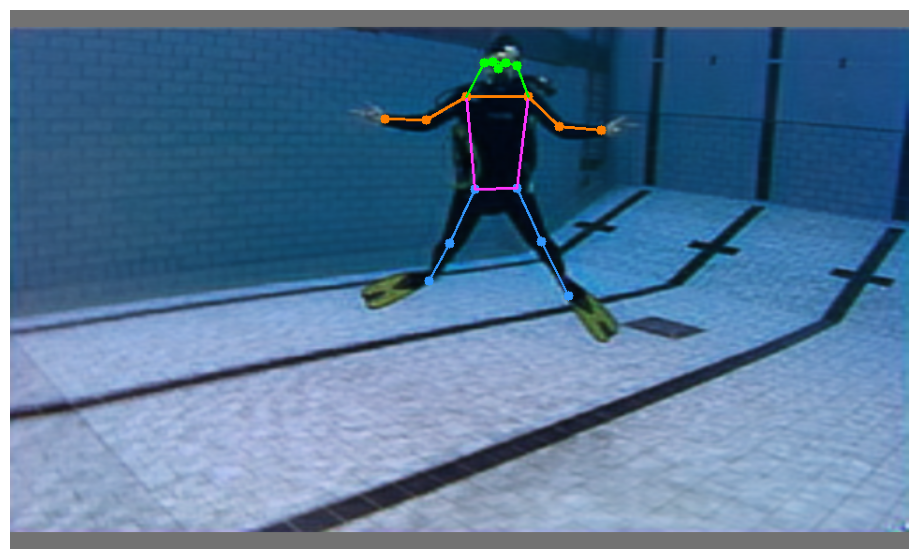

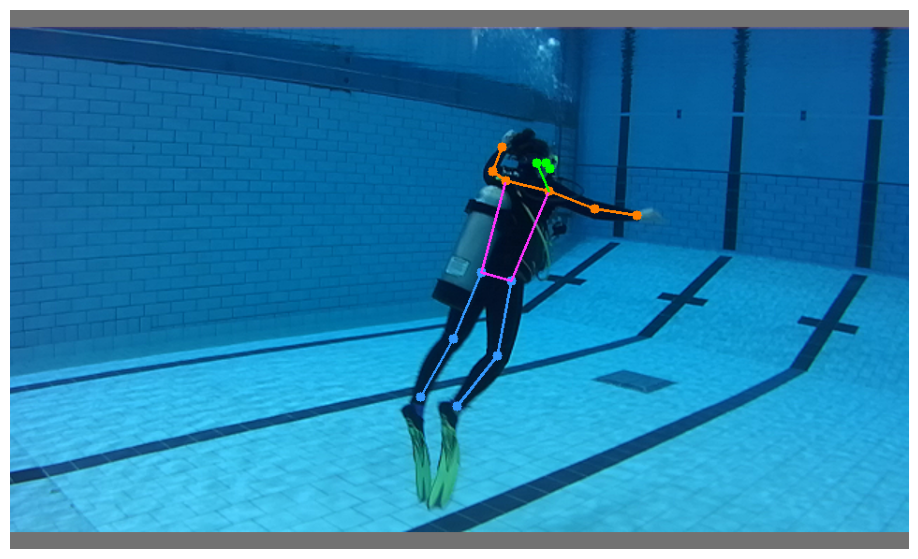

...

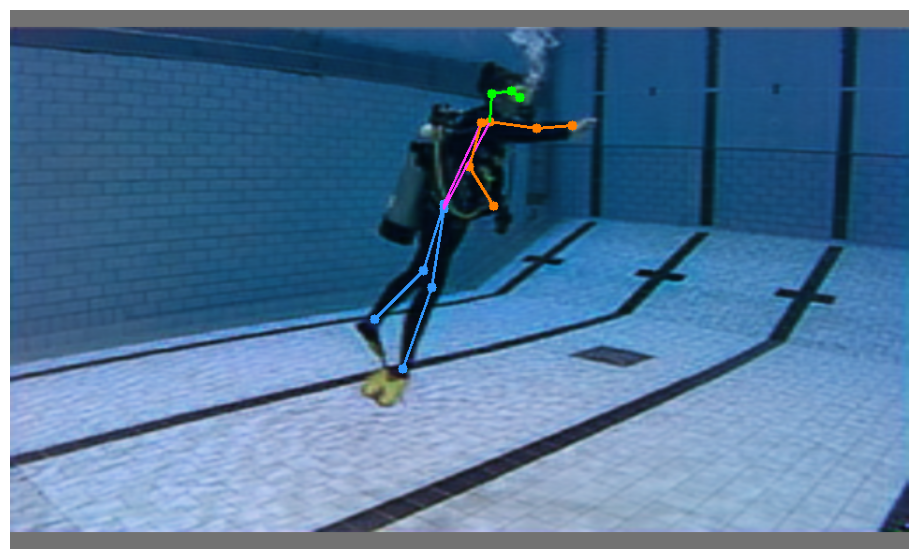

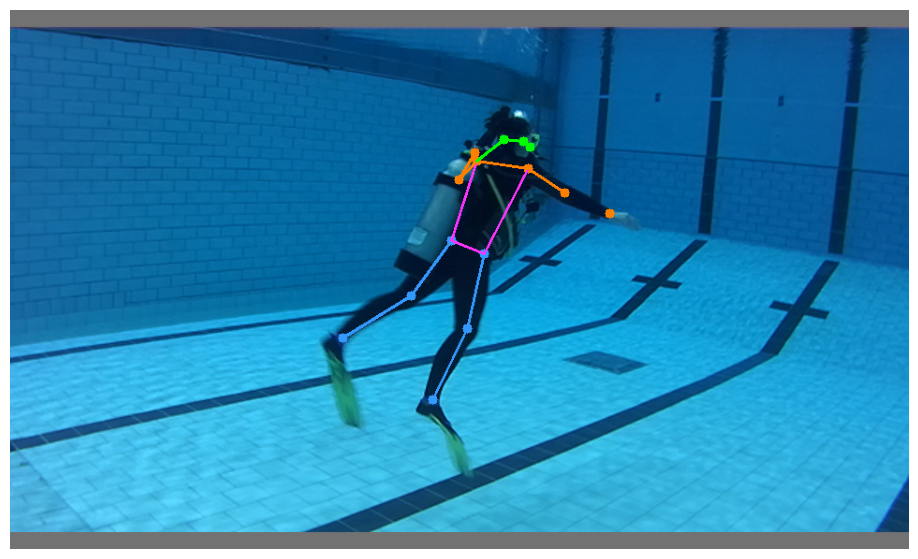

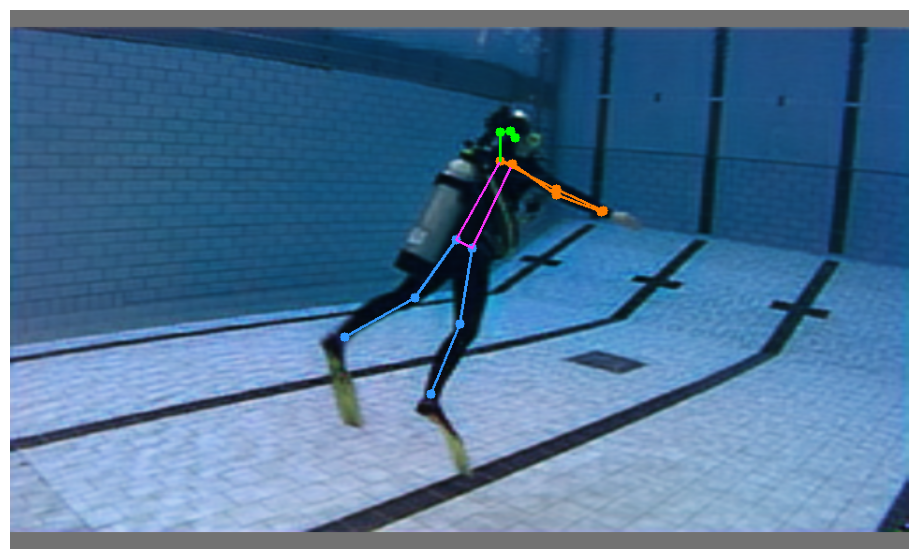

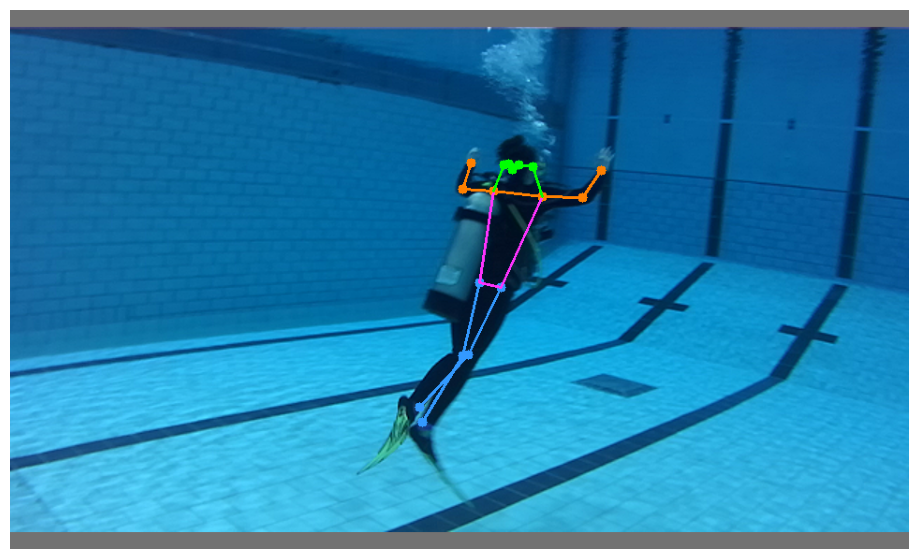

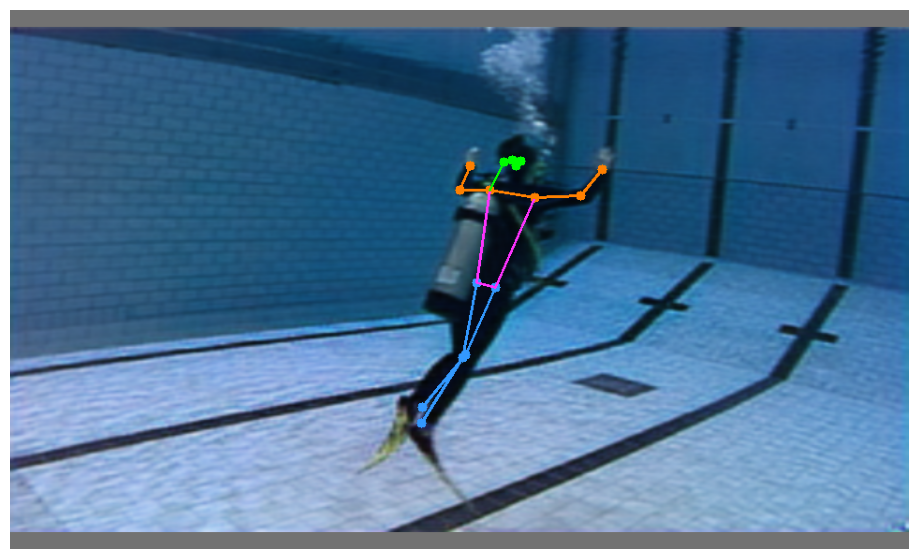

In [42]:
from os import listdir
from os.path import join

path = '/home/amitabha/capstone/pool_may051623/or/'
path_e = '/home/amitabha/capstone/pool_may051623/en/'

distances = []

for image_path in listdir(path): 
    original_path = join(path, image_path)
    enhanced_path = join(path_e, image_path)

    output, image = running_inference(cv2.imread(original_path))
    pose_image, coordinates1 = draw_keypoints(output, image, confidence=0.25, threshold=0.65)

    plt.figure(figsize=(30, 7))
    plt.axis("off")
    plt.imshow(pose_image)

    output, image = running_inference(cv2.imread(enhanced_path))
    pose_image, coordinates2 = draw_keypoints(output, image, confidence=0.25, threshold=0.65)

    plt.figure(figsize=(30, 7))
    plt.axis("off")
    plt.imshow(pose_image)

    #print(np.sum(np.linalg.norm(coordinates1[0][:, :2] - coordinates2[0][:, :2], axis=1)))

    distances.append(np.linalg.norm(coordinates1[0][:, :2] - coordinates2[0][:, :2], axis=1))

#print(distances)